In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))

In [2]:
from IPython.core.display import display, HTML
display(HTML(r"""<style id=hide>div.input{display:none;}</style><button type="button"onclick="var myStyle = document.getElementById('hide').sheet;myStyle.insertRule('div.input{display:inherit !important;}', 0);">Click me to Show all codes</button>"""))

In [3]:
import numpy as np
import pandas as pd
import glob
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno
import plotly.express as px

path = '../assessment_data/'
all_files = glob.glob(path+"/*.csv")


## Reading Main and all Support files

In [4]:
df_main = pd.read_csv(path+"MAIN.csv", index_col=None, header = 0)
print(len(df_main))
df_main

598269


,POLICY_NO,AGT_CD,S_BASE,RIDER_CD,COVERAGE_TYPE_IND,INS_UNIQUE_ID,PURCHASE_DT,PROD_CAT,PRODUCT_CD,ANP_RIDER,VIT_MBR_IND,PROD_SUBCAT_IND_1,PROD_SUBCAT_IND_2
0,1,3640,LAT,10102.0,R,P001664420,2020-03-26,NaN,ACC0,0.00,0,1,0
1,1,3640,LAT,10103.0,R,P001664420,2020-03-26,NaN,AHI0,0.00,0,1,1
2,1,3640,LAT,10108.0,R,P001664420,2020-03-26,NaN,VIT1,0.00,0,1,0
3,1,3640,LAT,10200.0,R,P001664420,2020-03-26,NaN,ART0,120.00,0,1,0
4,1,3640,LAT,10107.0,R,P001664420,2020-03-26,NaN,ART2,0.00,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
598264,575334,4812,LA,10101.0,R,P003663098,2019-09-13,NaN,APB2,54.08,0,1,0
598265,582035,1185,LA,10100.0,B,P010165693,2019-04-15,NaN,MER1,68.12,0,1,0
598266,582035,1185,LA,10101.0,R,P010165693,2019-04-15,NaN,APB2,28.66,0,1,0
598267,589062,3073,LA,10100.0,B,P010685096,2020-09-22,NaN,MER2,103.46,0,1,0


Add column name file to facillitate mergings 

In [5]:
# df_main['file']='main'
# df_main.head()

## IMPORTANT: MAIN has 598269 rows

- A good practice is to clean col names by lowering the case, stripping white spaces, and replace spaces with _
- row numbers are still the same.

In [6]:
## clean column names

def clean_colnames(df):
    #lowercase all names
    df.columns = df.columns.str.lower()
    # replace white spaces by underscores
    df.columns = [c.replace(' ', '_') for c in df]

    # strip leading white spaces
    df.columns = [c.lstrip() for c in df]

    # strip trailing white spaces
    df.columns = [c.rstrip() for c in df]
    return df

df_main = clean_colnames(df_main)
df_main

,policy_no,agt_cd,s_base,rider_cd,coverage_type_ind,ins_unique_id,purchase_dt,prod_cat,product_cd,anp_rider,vit_mbr_ind,prod_subcat_ind_1,prod_subcat_ind_2
0,1,3640,LAT,10102.0,R,P001664420,2020-03-26,NaN,ACC0,0.00,0,1,0
1,1,3640,LAT,10103.0,R,P001664420,2020-03-26,NaN,AHI0,0.00,0,1,1
2,1,3640,LAT,10108.0,R,P001664420,2020-03-26,NaN,VIT1,0.00,0,1,0
3,1,3640,LAT,10200.0,R,P001664420,2020-03-26,NaN,ART0,120.00,0,1,0
4,1,3640,LAT,10107.0,R,P001664420,2020-03-26,NaN,ART2,0.00,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
598264,575334,4812,LA,10101.0,R,P003663098,2019-09-13,NaN,APB2,54.08,0,1,0
598265,582035,1185,LA,10100.0,B,P010165693,2019-04-15,NaN,MER1,68.12,0,1,0
598266,582035,1185,LA,10101.0,R,P010165693,2019-04-15,NaN,APB2,28.66,0,1,0
598267,589062,3073,LA,10100.0,B,P010685096,2020-09-22,NaN,MER2,103.46,0,1,0


Because business is only interested in INFORCE AGENCY agents, we'll proceed with reading in AGENT and  then filtering MAIN. 

In [7]:
# read df_Agent and then filter only inforce and Agency
df_agent = pd.read_csv(path+"AGENT.csv", index_col=None, header = 0)

#clean the column names
df_agent = clean_colnames(df_agent)
df_agent.head()


,agt_channel,agt_status,agt_cd
0,AGENCY,INFORCE,1
1,AGENCY,INFORCE,2
2,AGENCY,INFORCE,3
3,AGENCY,INFORCE,4
4,AGENCY,INFORCE,5


#### Precheck to confirm that the agent code is unique

In [8]:
# confirm that agt_cd is unique
if df_agent['agt_cd'].nunique()==len(df_agent):
    print('Agent Code is unique')
else:
    print('Agent Code is not unique. Process breaks here. Please confirm with Business')
    end

Agent Code is unique


#### We should always make sure that during merging, the main data rows maintain the same. 

In [9]:
print('Number of rows: ', len(df_main))
print(list(df_main))
df_main = df_main.merge(df_agent, how='outer', on='agt_cd')
df_main_agent = df_main.copy()
print('Number of rows: ', len(df_main))
print(list(df_main))

Number of rows:  598269
['policy_no', 'agt_cd', 's_base', 'rider_cd', 'coverage_type_ind', 'ins_unique_id', 'purchase_dt', 'prod_cat', 'product_cd', 'anp_rider', 'vit_mbr_ind', 'prod_subcat_ind_1', 'prod_subcat_ind_2']
Number of rows:  598269
['policy_no', 'agt_cd', 's_base', 'rider_cd', 'coverage_type_ind', 'ins_unique_id', 'purchase_dt', 'prod_cat', 'product_cd', 'anp_rider', 'vit_mbr_ind', 'prod_subcat_ind_1', 'prod_subcat_ind_2', 'agt_channel', 'agt_status']


- After merging, we see that we get agt_channel and agt_status from df_agent inside df_main.
- Since we're only interested in Inforce and AGency, let's filter that out.
- you can hover on the bar or click on the legend to see how many INFORCE and so on.

In [10]:
# df_agent.groupby(["agt_channel"]).count().reset_index().plot(x='agt_status', y='value', kind='bar')
new_df = df_agent.groupby((["agt_channel", 'agt_status'])).count().reset_index()
new_df = new_df.rename(columns={'agt_cd':'count'})
px.bar(data_frame=new_df, x='agt_channel', y='count', color ='agt_status')
 

In [11]:
print('Original length of MAIN: ', len(df_main))
df_main = df_main[(df_main['agt_channel']=='AGENCY') & (df_main['agt_status']=='INFORCE')]
print('After applying filters for INFORCE and AGENCY: ', len(df_main))

df_main


Original length of MAIN:  598269
After applying filters for INFORCE and AGENCY:  495854


,policy_no,agt_cd,s_base,rider_cd,coverage_type_ind,ins_unique_id,purchase_dt,prod_cat,product_cd,anp_rider,vit_mbr_ind,prod_subcat_ind_1,prod_subcat_ind_2,agt_channel,agt_status
0,1,3640,LAT,10102.0,R,P001664420,2020-03-26,NaN,ACC0,0.00,0,1,0,AGENCY,INFORCE
1,1,3640,LAT,10103.0,R,P001664420,2020-03-26,NaN,AHI0,0.00,0,1,1,AGENCY,INFORCE
2,1,3640,LAT,10108.0,R,P001664420,2020-03-26,NaN,VIT1,0.00,0,1,0,AGENCY,INFORCE
3,1,3640,LAT,10200.0,R,P001664420,2020-03-26,NaN,ART0,120.00,0,1,0,AGENCY,INFORCE
4,1,3640,LAT,10107.0,R,P001664420,2020-03-26,NaN,ART2,0.00,0,1,0,AGENCY,INFORCE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
598255,551619,4212,LA,10100.0,B,P010373499,2019-09-13,NaN,MER1,88.30,0,1,0,AGENCY,INFORCE
598256,583668,4212,LA,10100.0,B,P002828561,2020-08-05,NaN,MER2,117.80,0,1,0,AGENCY,INFORCE
598257,583668,4212,LA,10101.0,R,P002828561,2020-08-05,NaN,APH1,29.60,0,1,0,AGENCY,INFORCE
598267,589062,3073,LA,10100.0,B,P010685096,2020-09-22,NaN,MER2,103.46,0,1,0,AGENCY,INFORCE


### Incorporating SQL LOGIC: 
- SQL logic is also provided where POLA is replaced with Accident.

In [12]:
# incorporate the SQL logics into the codes here.

## df_b
print('Original: ', df_main['s_base'].unique())
df_main['s_base'] = df_main['s_base'].replace(['POLA'], 'Accident')
print('After Sql Logic: ', df_main['s_base'].unique())
df_main

Original:  ['LAT' 'LA' 'POLA']
After Sql Logic:  ['LAT' 'LA' 'Accident']


,policy_no,agt_cd,s_base,rider_cd,coverage_type_ind,ins_unique_id,purchase_dt,prod_cat,product_cd,anp_rider,vit_mbr_ind,prod_subcat_ind_1,prod_subcat_ind_2,agt_channel,agt_status
0,1,3640,LAT,10102.0,R,P001664420,2020-03-26,NaN,ACC0,0.00,0,1,0,AGENCY,INFORCE
1,1,3640,LAT,10103.0,R,P001664420,2020-03-26,NaN,AHI0,0.00,0,1,1,AGENCY,INFORCE
2,1,3640,LAT,10108.0,R,P001664420,2020-03-26,NaN,VIT1,0.00,0,1,0,AGENCY,INFORCE
3,1,3640,LAT,10200.0,R,P001664420,2020-03-26,NaN,ART0,120.00,0,1,0,AGENCY,INFORCE
4,1,3640,LAT,10107.0,R,P001664420,2020-03-26,NaN,ART2,0.00,0,1,0,AGENCY,INFORCE
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
598255,551619,4212,LA,10100.0,B,P010373499,2019-09-13,NaN,MER1,88.30,0,1,0,AGENCY,INFORCE
598256,583668,4212,LA,10100.0,B,P002828561,2020-08-05,NaN,MER2,117.80,0,1,0,AGENCY,INFORCE
598257,583668,4212,LA,10101.0,R,P002828561,2020-08-05,NaN,APH1,29.60,0,1,0,AGENCY,INFORCE
598267,589062,3073,LA,10100.0,B,P010685096,2020-09-22,NaN,MER2,103.46,0,1,0,AGENCY,INFORCE


To complete MAIN, i need to join supporting files B,C, D, E.

In [13]:
# read in the files and create a column called file so I know which information came from where. 
df_b = pd.read_csv(path+"B.csv", index_col=None, header = 0)
df_b['file'] = 'b'
df_c = pd.read_csv(path+"C.csv", index_col=None, header = 0)
df_c['file'] = 'c'
df_d = pd.read_csv(path+"D.csv", index_col=None, header = 0)
df_d['file'] = 'd'
df_e = pd.read_csv(path+"E.csv", index_col=None, header = 0)
df_e['file'] = 'e'
    

# Merge Main with B, C, D, E
df_support = [df_b, df_c, df_d, df_e]

In [14]:
# clean support colnames
for df in df_support:
    df=clean_colnames(df)
df

,purpose_code,char_value,char_value2,file
0,HS25,Medical,NaN,e
1,AHM704,Medical,NaN,e
2,AEH1,Medical,NaN,e
3,ECP4,Medical,NaN,e
4,HS21,Medical,NaN,e
...,...,...,...,...
377,MED0,Medical,NaN,e
378,HB01,Medical,NaN,e
379,HS17,Medical,NaN,e
380,MPL1,Medical,NaN,e


### Incorporating SQL LOGIC: 

In [15]:
# incorporate the SQL logics into the codes here.

## df_b to change Medical to Other Medical
print('Original: ', df_b['char_value'].unique())
df_b['char_value'] = df_b['char_value'].str.strip()
df_b['char_value'] = df_b['char_value'].replace(['Medical'], 'Other Medical')
print('After Sql Logic: ', df_b['char_value'].unique())
df_b

Original:  ['Savers' 'Life' 'Payor/Waiver' 'Medical' 'Critical Illness' 'Income'
 'Disability' 'Accident' 'Endowment']
After Sql Logic:  ['Savers' 'Life' 'Payor/Waiver' 'Other Medical' 'Critical Illness'
 'Income' 'Disability' 'Accident' 'Endowment']


,purpose_code,char_value,char_value2,file
0,STU1,Savers,LA TAKAFUL,b
1,AD11,Savers,LA TAKAFUL,b
2,AL70,Life,LA TAKAFUL,b
3,ACE1,Payor/Waiver,LA TAKAFUL,b
4,AT63,Savers,LA,b
...,...,...,...,...
223,FUNE,Life,LA TAKAFUL,b
224,T21S,Life,LA TAKAFUL,b
225,77SW,Payor/Waiver,LA,b
226,78CI,Critical Illness,LA,b


In [16]:
## df_c to change Medical to Other Medical
print('Original: ', df_c['char_value'].unique())
df_c['char_value'] = df_c['char_value'].str.strip()
df_c['char_value'] = df_c['char_value'].replace(['Medical'], 'Other Medical')
print('After Sql Logic: ', df_c['char_value'].unique())
df_c

Original:  ['Endowment' 'Accident' 'Life' 'Payor/Waiver' 'Disability' 'Medical'
 'Income' 'Critical Illness' 'Savers']
After Sql Logic:  ['Endowment' 'Accident' 'Life' 'Payor/Waiver' 'Disability' 'Other Medical'
 'Income' 'Critical Illness' 'Savers']


,purpose_code,char_value,char_value2,file
0,PS2001,Endowment,NaN,c
1,ADR2,Accident,NaN,c
2,MPR7,Life,NaN,c
3,EXEL,Life,NaN,c
4,PAC5N6,Accident,NaN,c
...,...,...,...,...
7402,PJ1,Accident,NaN,c
7403,QRA,Accident,NaN,c
7404,72PW,Payor/Waiver,NaN,c
7405,PS21,Savers,NaN,c


## Exploring and merging the support files

Let's merge all the support files. and create a column calld merged_name by merging purpose code and char_value. Didn't use char_value2 cos mostly missing. /

In [17]:

df2=[]
df_supportMerged =[]
for df in df_support:
#     df['CHAR_VALUE2'] = df['CHAR']
    df['merged_name'] = df[df.columns[0:2]].apply(
    lambda x: ','.join(x.dropna().astype(str)),
    axis=1)
    df2.append(df)

df_supportMerged = pd.concat(df2)
df_supportMerged#.sort_values(by='merged_name', ascending=True) ## Final df_support

,purpose_code,char_value,char_value2,file,merged_name
0,STU1,Savers,LA TAKAFUL,b,"STU1,Savers"
1,AD11,Savers,LA TAKAFUL,b,"AD11,Savers"
2,AL70,Life,LA TAKAFUL,b,"AL70,Life"
3,ACE1,Payor/Waiver,LA TAKAFUL,b,"ACE1,Payor/Waiver"
4,AT63,Savers,LA,b,"AT63,Savers"
...,...,...,...,...,...
377,MED0,Medical,NaN,e,"MED0,Medical"
378,HB01,Medical,NaN,e,"HB01,Medical"
379,HS17,Medical,NaN,e,"HS17,Medical"
380,MPL1,Medical,NaN,e,"MPL1,Medical"


<AxesSubplot:>

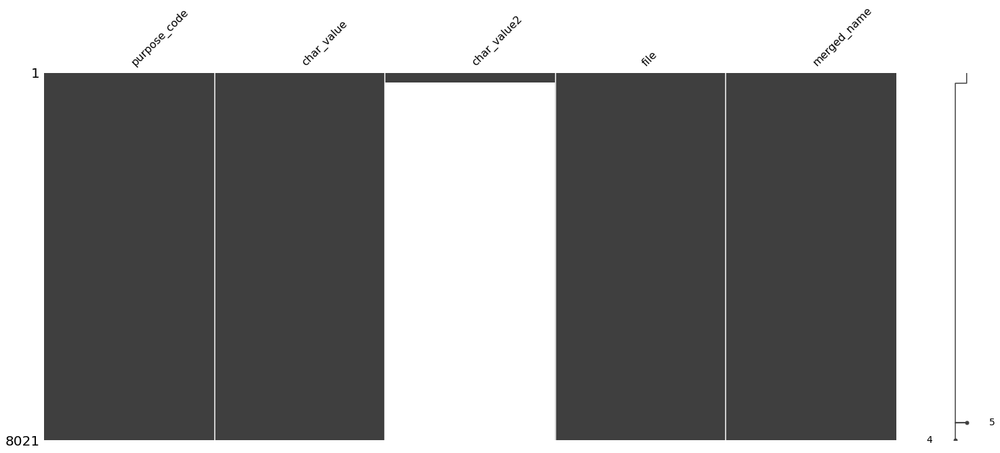

In [18]:
# exploring Support files
import missingno as msno
msno.matrix(df_supportMerged)

<AxesSubplot:>

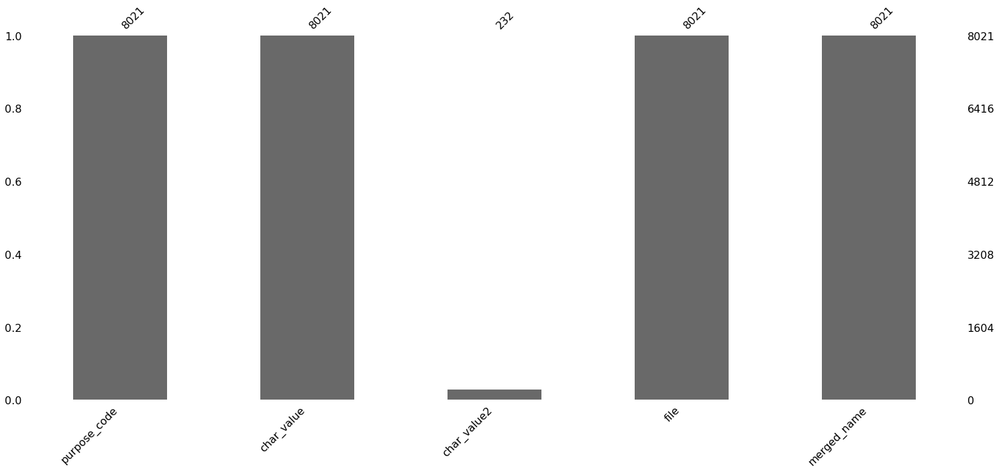

In [19]:
msno.bar(df_supportMerged)

In [20]:
def missing_zero_values_table(df):
        mis_val = df.isnull().sum()
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        mz_table = pd.concat([mis_val, mis_val_percent], axis=1)
        mz_table = mz_table.rename(columns = {0 : 'Missing Values', 1 : '% of Total Values'})
        mz_table['Data Type'] = df.dtypes
        mz_table = mz_table[
            mz_table.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns and " + str(df.shape[0]) + " Rows.\n"      
            "There are " + str(mz_table.shape[0]) +
              " columns that have missing values.")
        return mz_table

missing_zero_values_table(df_supportMerged)

Your selected dataframe has 5 columns and 8021 Rows.
There are 1 columns that have missing values.


,Missing Values,% of Total Values,Data Type
char_value2,7789,97.1,object


Check whether merged_name is unique so that we can try to merge support with main.

In [21]:
check_duplicate = pd.DataFrame(df_supportMerged[['merged_name']].value_counts())#.reset_index().sort_values(by=0, ascending=False)
check_duplicate = check_duplicate.reset_index().rename(columns = {0:'Frequency'}).sort_values(by='merged_name')
print('Frequency starts with 1, merged_name is all unique values')
check_duplicate


Frequency starts with 1, merged_name is all unique values


,merged_name,Frequency
11,"0ADBGN6,Accident",1
6672,"0ADBGN7,Accident",1
5353,"0ADBLN6,Accident",1
5352,"0ADBLN7,Accident",1
5351,"0CB1N6,Accident",1
...,...,...
2672,"YRT8,Life",1
2671,"YRT9,Life",1
2670,"Z00001,Life",1
2669,"Z00002,Life",1


In [22]:
check_duplicate = pd.DataFrame(df_supportMerged[['merged_name']].value_counts())#.reset_index().sort_values(by=0, ascending=False)
check_duplicate = check_duplicate.reset_index().rename(columns = {0:'Frequency'})
check_duplicate

check_support_dupe = df_supportMerged.merge(check_duplicate, on='merged_name')
check_support_dupe
check_support_dupe.sort_values(by=['Frequency','merged_name'], ascending=False)
if len(check_support_dupe[check_support_dupe['Frequency']!=1]) != 0:
    print('Duplicates Found')
    df_support_clean = check_support_dupe.drop_duplicates(subset="merged_name",keep='first')
else:
    print('No Dupes in merged_name. Please check whether purpose_code is unique to proceed')
    df_support_clean = check_support_dupe.copy()
df_support_clean = df_support_clean.reset_index(drop=True)
df_support_clean

Duplicates Found


,purpose_code,char_value,char_value2,file,merged_name,Frequency
0,STU1,Savers,LA TAKAFUL,b,"STU1,Savers",1
1,AD11,Savers,LA TAKAFUL,b,"AD11,Savers",1
2,AL70,Life,LA TAKAFUL,b,"AL70,Life",1
3,ACE1,Payor/Waiver,LA TAKAFUL,b,"ACE1,Payor/Waiver",1
4,AT63,Savers,LA,b,"AT63,Savers",1
...,...,...,...,...,...,...
8008,MED0,Medical,NaN,e,"MED0,Medical",1
8009,HB01,Medical,NaN,e,"HB01,Medical",1
8010,HS17,Medical,NaN,e,"HS17,Medical",1
8011,MPL1,Medical,NaN,e,"MPL1,Medical",1


In [23]:
df_support_clean['purpose_code'].nunique()==len(df_support_clean)
print('Purpose code is NOT unique. Please do not proceed')

Purpose code is NOT unique. Please do not proceed


## Checking for support's duplicates.


In [24]:
df_supportMerged['merged_name'].nunique() ==len(df_supportMerged) ## false means there are duplicates

False

In [25]:
support_duplicates = df_supportMerged[df_supportMerged.duplicated(subset=['merged_name'], keep=False)].sort_values(by='merged_name')
print("Rows of duplicates in support data: ", len(support_duplicates))
support_duplicates
## omg duplicates

## assumption: support's df must have unique purpose code. 
## assumption: Since char_value2 is already null, I'll drop the null and keep the one with value. 

Rows of duplicates in support data:  16


,purpose_code,char_value,char_value2,file,merged_name
120,29VC,Life,LA,b,"29VC,Life"
885,29VC,Life,NaN,c,"29VC,Life"
161,30VC,Life,LA,b,"30VC,Life"
886,30VC,Life,NaN,c,"30VC,Life"
1,APH1,Medical,LA,d,"APH1,Medical"
330,APH1,Medical,NaN,e,"APH1,Medical"
163,APH1,Other Medical,LA,b,"APH1,Other Medical"
6441,APH1,Other Medical,NaN,c,"APH1,Other Medical"
192,AT61,Savers,LA,b,"AT61,Savers"
6459,AT61,Savers,NaN,c,"AT61,Savers"


This is not good. We need purpose_code to be unique so that it can be mapped into main data. 

### Assumption: support's df must have unique purpose code. 
### Assumption: Since char_value2 is already null, I'll drop the null and keep the one with value. 

From the above we see duplicates. so , we're gonna just keep the first occuring one. 

In [26]:

print('Before removing duplicates: ', len(df_supportMerged))
df_supportMerged = df_supportMerged.drop_duplicates(subset=['merged_name'], keep = 'first')
print('After removing duplicates: ', len(df_supportMerged))
df_supportMerged[df_supportMerged.duplicated(subset=['merged_name'], keep=False)].sort_values(by='merged_name') # just to check no more duplicates.

Before removing duplicates:  8021
After removing duplicates:  8013


,purpose_code,char_value,char_value2,file,merged_name


In [27]:
## now check whether purpose code is finally unique
df_supportMerged['purpose_code'].nunique() == len(df_supportMerged) ## still not unique.
print("purpose Code is not unique.")
#
# need to see wheich purpose codes are still duplicated.

purpose Code is not unique.


In [28]:
check_duplicate_pcode = df_supportMerged[['purpose_code']].value_counts()
check_duplicate_pcode = check_duplicate_pcode.reset_index().rename(columns = {0:'Frequency'}).sort_values(by=['Frequency', 'purpose_code'], ascending=False)
check_duplicate_pcode
check_duplicate_pcode1 = check_duplicate_pcode[check_duplicate_pcode['Frequency']!=1].sort_values(by=['Frequency'])#, 'purpose_code'], ascending=False)
check_duplicate_pcode1

,purpose_code,Frequency
288,XLC70N7,2
1,H216,2
28,H221,2
30,H222,2
55,H223,2
...,...,...
328,MEDI1,2
327,MEDI2,2
326,MEDS,2
322,MER2,2


In [29]:
df_duplicate_pcode2=[]
df_duplicate_pcode3=[]

for code in check_duplicate_pcode1["purpose_code"].unique():
    df_duplicate_pcode = df_supportMerged[df_supportMerged['purpose_code']==code]
    df_duplicate_pcode2.append(df_duplicate_pcode)
    
df_duplicate_pcode3= pd.concat(df_duplicate_pcode2)


In [30]:
df_duplicate_pcode3

,purpose_code,char_value,char_value2,file,merged_name
5063,XLC70N7,Other Medical,NaN,c,"XLC70N7,Other Medical"
267,XLC70N7,Medical,NaN,e,"XLC70N7,Medical"
5657,H216,Other Medical,NaN,c,"H216,Other Medical"
294,H216,Medical,NaN,e,"H216,Medical"
2205,H221,Other Medical,NaN,c,"H221,Other Medical"
...,...,...,...,...,...
321,MEDS,Medical,NaN,e,"MEDS,Medical"
7385,MER2,Other Medical,NaN,c,"MER2,Other Medical"
381,MER2,Medical,NaN,e,"MER2,Medical"
4632,ACD1,Other Medical,NaN,c,"ACD1,Other Medical"


In [31]:
missing_zero_values_table(df_support_clean)

Your selected dataframe has 6 columns and 8013 Rows.
There are 1 columns that have missing values.


,Missing Values,% of Total Values,Data Type
char_value2,7781,97.1,object


## Important:
I do not recommend moving on from here without discussing with Business. 
1. The only way to merge main and support files is to merge by a unique identifier, which in our case is Purpose Code. If the Purpose code contains duplicates, then the main data will increase in rows. 
1. I am also not able to join by s_base and char_value2 because char_value2 is mostly missing (97.1%). 
1. I am not able to just remove duplicated purpose code because in char_value (picture above or refer to df_duplicate_pcode3.csv), most of the duplicates are due to Other Medical and Medical (Which was required to change in SQL logic.)
1. There are also other different types of char_value with duplicated purpose code. 
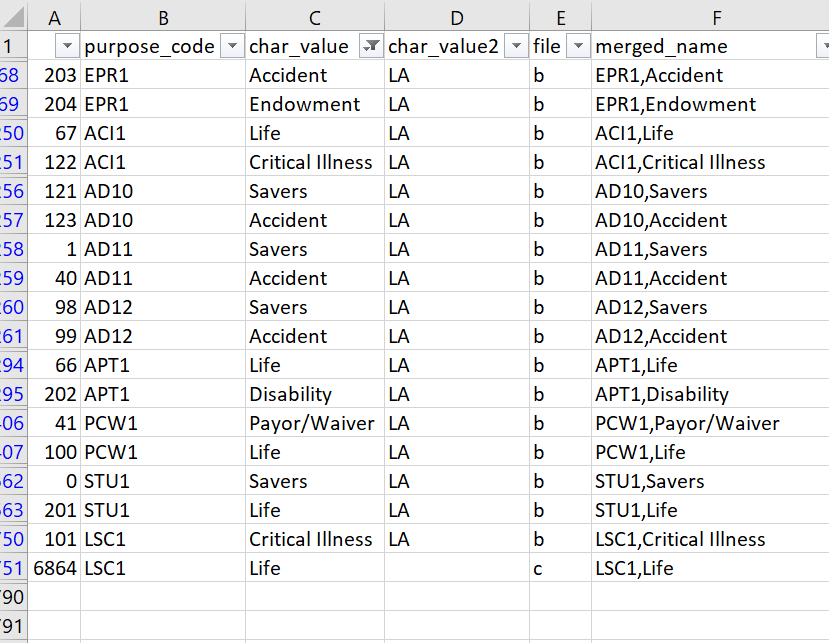

###  for the sake of the exercise, as I have spent a lot of time with duplicates, I will just drop duplicates and keep the first occuring one. 
## This is NOT a recommended step. 
####  assuming we proceed to merge(Which i do not recommend), i want to check whether s_base and char_value2 has problems or not. 

In [32]:
## assuming we proceed to merge(Which i do not recommend), i want to check whether s_base and char_value2 has problems or not. 
df_main1 = df_main.copy()
print('Number of data rows in Main: ', len(df_main1))
# print('Number of data rows in Support: ',len(df_support_clean))
df_support_clean['product_cd'] = df_support_clean['purpose_code'].copy()
df_support_clean
df_main1 = pd.merge(df_main1, df_support_clean, how='left', on = 'product_cd')#left_on='product_cd', right_on='purpose_code')
print('Number of data rows in Main after merging with Support: ',len(df_main1))
print('Number of data rows should remain the same after merging. Because the number increased, it means that there are duplicates')
## WHY DID MY LENGTH OF DF GO Up?! definitely duplicates coming from the merge. 
# df_main1 = df_main1.reset_index(drop=True)
# df_main1

Number of data rows in Main:  495854
Number of data rows in Main after merging with Support:  586020
Number of data rows should remain the same after merging. Because the number increased, it means that there are duplicates


In [33]:
df_main1.head()

,policy_no,agt_cd,s_base,rider_cd,coverage_type_ind,ins_unique_id,purchase_dt,prod_cat,product_cd,anp_rider,...,prod_subcat_ind_1,prod_subcat_ind_2,agt_channel,agt_status,purpose_code,char_value,char_value2,file,merged_name,Frequency
0,1,3640,LAT,10102.0,R,P001664420,2020-03-26,NaN,ACC0,0.0,...,1,0,AGENCY,INFORCE,ACC0,Critical Illness,NaN,c,"ACC0,Critical Illness",1
1,1,3640,LAT,10103.0,R,P001664420,2020-03-26,NaN,AHI0,0.0,...,1,1,AGENCY,INFORCE,AHI0,Income,NaN,c,"AHI0,Income",1
2,1,3640,LAT,10108.0,R,P001664420,2020-03-26,NaN,VIT1,0.0,...,1,0,AGENCY,INFORCE,VIT1,Life,NaN,c,"VIT1,Life",1
3,1,3640,LAT,10200.0,R,P001664420,2020-03-26,NaN,ART0,120.0,...,1,0,AGENCY,INFORCE,ART0,Savers,NaN,c,"ART0,Savers",1
4,1,3640,LAT,10107.0,R,P001664420,2020-03-26,NaN,ART2,0.0,...,1,0,AGENCY,INFORCE,ART2,Accident,NaN,c,"ART2,Accident",1


In [34]:

check_duplicate_main = df_main1[['product_cd', 'merged_name', 'file']].value_counts()
check_duplicate_main = check_duplicate_main.reset_index().rename(columns = {0:'Frequency'}).sort_values(by=['Frequency','merged_name'], ascending=False)
check_duplicate_main
## going back to df_support_clean, im gonna drop all other medical from the lists of codes at the top. 
df_support_clean.head()
df2=[]
df3=[]
df4=[]

for productcode in check_duplicate_main['product_cd'].unique():
#     print(productcode)
    if productcode == 'AD11':
        df1 = df_main1[df_main1['product_cd'] == productcode]
        df1['char_value'] = df1['char_value'].replace(['Savers'], 'Accident/Savers')
        df1['char_value'] = df1['char_value'].replace(['Accident'], 'Accident/Savers')
        print(df1)
    elif productcode == 'APT1': 
        df1 = df_main1[df_main1['product_cd'] == productcode]
        df1['char_value'] = df1['char_value'].replace(['Disability'], 'Disability/Life')
        df1['char_value'] = df1['char_value'].replace(['Life'], 'Disability/Life')
    else:
        df1 = df_main1[df_main1['product_cd'] == productcode]
        df1['char_value'] = df1['char_value'].replace(['Medical'], 'Medical/Other Medical')
        df1['char_value'] = df1['char_value'].replace(['Other Medical'], 'Medical/Other Medical')
    df2.append(df1)
df3 = pd.concat(df2)
df3
#         df1['char_value'] = df1 

C:\Users\mildred.epui\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\mildred.epui\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\mildred.epui\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .l

        policy_no  agt_cd s_base  rider_cd coverage_type_ind ins_unique_id  \
296995      96224    4418    LAT   10300.0                 R    P002238412   
296996      96224    4418    LAT   10300.0                 R    P002238412   

       purchase_dt prod_cat product_cd  anp_rider  ...  prod_subcat_ind_1  \
296995  2020-08-29      NaN       AD11        0.0  ...                  1   
296996  2020-08-29      NaN       AD11        0.0  ...                  1   

        prod_subcat_ind_2  agt_channel agt_status purpose_code  \
296995                  0       AGENCY    INFORCE         AD11   
296996                  0       AGENCY    INFORCE         AD11   

             char_value char_value2 file    merged_name Frequency  
296995  Accident/Savers  LA TAKAFUL    b    AD11,Savers         1  
296996  Accident/Savers          LA    b  AD11,Accident         1  

[2 rows x 21 columns]


,policy_no,agt_cd,s_base,rider_cd,coverage_type_ind,ins_unique_id,purchase_dt,prod_cat,product_cd,anp_rider,...,prod_subcat_ind_1,prod_subcat_ind_2,agt_channel,agt_status,purpose_code,char_value,char_value2,file,merged_name,Frequency
523,408,3642,LA,10102.0,R,P010434440,2019-11-26,NaN,APM5,0.0,...,0,0,AGENCY,INFORCE,APM5,Medical/Other Medical,NaN,c,"APM5,Other Medical",1
524,408,3642,LA,10102.0,R,P010434440,2019-11-26,NaN,APM5,0.0,...,0,0,AGENCY,INFORCE,APM5,Medical/Other Medical,NaN,e,"APM5,Medical",1
532,973,3642,LA,10102.0,R,P005188330,2020-08-21,NaN,APM5,0.0,...,1,0,AGENCY,INFORCE,APM5,Medical/Other Medical,NaN,c,"APM5,Other Medical",1
533,973,3642,LA,10102.0,R,P005188330,2020-08-21,NaN,APM5,0.0,...,1,0,AGENCY,INFORCE,APM5,Medical/Other Medical,NaN,e,"APM5,Medical",1
534,1248,3642,LA,10102.0,R,P002711286,2020-09-29,NaN,APM5,0.0,...,1,0,AGENCY,INFORCE,APM5,Medical/Other Medical,NaN,c,"APM5,Other Medical",1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
497935,325605,1624,LA,10200.0,R,P005339774,2020-10-20,NaN,17IA,0.0,...,0,0,AGENCY,INFORCE,17IA,Savers,NaN,c,"17IA,Savers",1
48115,26334,10,LA,10200.0,R,P001313916,2019-06-27,NaN,11EF,1098.6,...,1,0,AGENCY,INFORCE,11EF,Savers,NaN,c,"11EF,Savers",1
497934,325605,1624,LA,10100.0,B,P005339774,2020-10-20,NaN,107A,6420.0,...,0,0,AGENCY,INFORCE,107A,Life,NaN,c,"107A,Life",1
48116,26334,10,LA,10100.0,B,P001313916,2019-06-27,Cat 1,101F,1713.6,...,1,0,AGENCY,INFORCE,101F,Life,NaN,c,"101F,Life",1


In [35]:
df3[df3['product_cd']=='AD11']

,policy_no,agt_cd,s_base,rider_cd,coverage_type_ind,ins_unique_id,purchase_dt,prod_cat,product_cd,anp_rider,...,prod_subcat_ind_1,prod_subcat_ind_2,agt_channel,agt_status,purpose_code,char_value,char_value2,file,merged_name,Frequency
296995,96224,4418,LAT,10300.0,R,P002238412,2020-08-29,NaN,AD11,0.0,...,1,0,AGENCY,INFORCE,AD11,Accident/Savers,LA TAKAFUL,b,"AD11,Savers",1
296996,96224,4418,LAT,10300.0,R,P002238412,2020-08-29,NaN,AD11,0.0,...,1,0,AGENCY,INFORCE,AD11,Accident/Savers,LA,b,"AD11,Accident",1


The above shows that the difference is in char_value2 where we have 1 record of LA Takaful and another one of LA. 
Let's see what combinatiosn we have of s_base and char_value2.


In [36]:
df_main1["exists"] = df_main1.drop("s_base", 1).isin(df_main1["s_base"]).any(1)
df_main1[df_main1['exists']==False]
df_false = df_main1[df_main1['exists']==False]

df_false['char_value2'].isnull().sum == len(df_false) ## It's not all null!! 
df_false = df_false.dropna(subset=['char_value2'])[df_false.columns] # found 118 columns that are not null
df_false[['s_base', 'char_value2']].value_counts()

C:\Users\mildred.epui\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:1: FutureWarning:

In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only



s_base  char_value2
LAT     LA TAKAFUL     15138
LA      LA TAKAFUL        96
LAT     LA                 1
dtype: int64

Based on initial findings, I found that s_base and char_value2 are conflicting. 
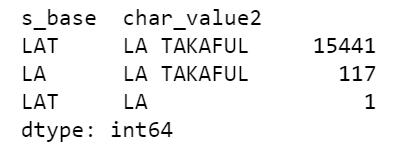

 - can see 15441 rows where s_base is LAT , but char value2 is LA Takaful, also vice versa. 
 - ### Business To-Do: Check whether it's a record keeping problem, or if LA and LA takaful is the same, then the value should be standardized. 
 - It's causing duplicate problems, which will affect our data preprocessing.
 - so I'll create another column where the new s_base is combination name of s_base+ char_Value2
 - And because there are nulls, I will add the nulls as a different name, so now we will have more s_base unique values. 
 - why? cos cannot assume sbase is correct, or char value2 is correct.need to find out how it's populated.
 - If agents fill it, means they don't know the difference?

The above only adds up to 15235, which is much lower than our original Main Data rows of 586020. It's because char_vlaue2 has blanks. let's fill it in and see how many combinations we have. 

In [37]:
 # there are  566317 rows but only 14056 rows are detected. so let's try to fill in null as 'BLANK' and the count again
df_main1['char_value2'].fillna(value='BLANKS', inplace=True)
df_main1['char_value2'].unique()
df_main1[['s_base', 'char_value2']].value_counts()

### omg, LA in s_base is connected to BLANKS, LA, LA TAKAFUL in char value2. 
### i'll assume LA, LAT, LA Takaful are all the same.I'm not suppsoed to but to not waste time, i'll just assume they're all the same. the changes will be done in df_main, 
## and then the whole notebook needs to be rerun again.
# seriousnly need some standardization in this. so many duplicates. 

## end here, and let's run the next notebook. 

s_base    char_value2
LA        BLANKS         385533
LAT       BLANKS         136085
LA        LA              32846
Accident  BLANKS          16321
LAT       LA TAKAFUL      15138
LA        LA TAKAFUL         96
LAT       LA                  1
dtype: int64

- Now we have all 586020. However, LA in s_base is connected to BLANKS, LA, LA TAKAFUL in char value2.
- We also have LAT as LA Takaful and vice versa.
- ASSUMPTION: based on the combinations above, LA, LAT, LA Takaful are all the same.
- moving forward, we'll change all LA, LAT, LA Takaful to LA. 

In [38]:
# ## here's where we clean the LA/LA TAKAFUL
df_supportMerged['char_value2'] = df_supportMerged['char_value2'].replace(['LA TAKAFUL'], 'LA')

C:\Users\mildred.epui\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [39]:
# df_duplicate_pcode3.to_csv('duplicate_pcode3.csv')
df_duplicate_pcode3
## honestly i've spent too much time with the support files' duplicates.


,purpose_code,char_value,char_value2,file,merged_name
5063,XLC70N7,Other Medical,NaN,c,"XLC70N7,Other Medical"
267,XLC70N7,Medical,NaN,e,"XLC70N7,Medical"
5657,H216,Other Medical,NaN,c,"H216,Other Medical"
294,H216,Medical,NaN,e,"H216,Medical"
2205,H221,Other Medical,NaN,c,"H221,Other Medical"
...,...,...,...,...,...
321,MEDS,Medical,NaN,e,"MEDS,Medical"
7385,MER2,Other Medical,NaN,c,"MER2,Other Medical"
381,MER2,Medical,NaN,e,"MER2,Medical"
4632,ACD1,Other Medical,NaN,c,"ACD1,Other Medical"


In [40]:
df_supportMerged[df_supportMerged['purpose_code']=='APH1']

,purpose_code,char_value,char_value2,file,merged_name
163,APH1,Other Medical,LA,b,"APH1,Other Medical"
1,APH1,Medical,LA,d,"APH1,Medical"


<AxesSubplot:>

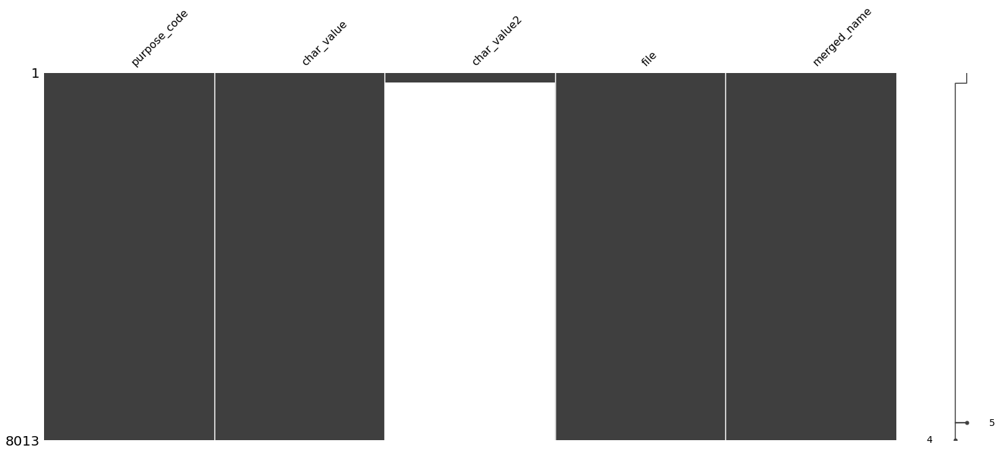

In [41]:
# exploring Support files
import missingno as msno
msno.matrix(df_supportMerged)

<AxesSubplot:>

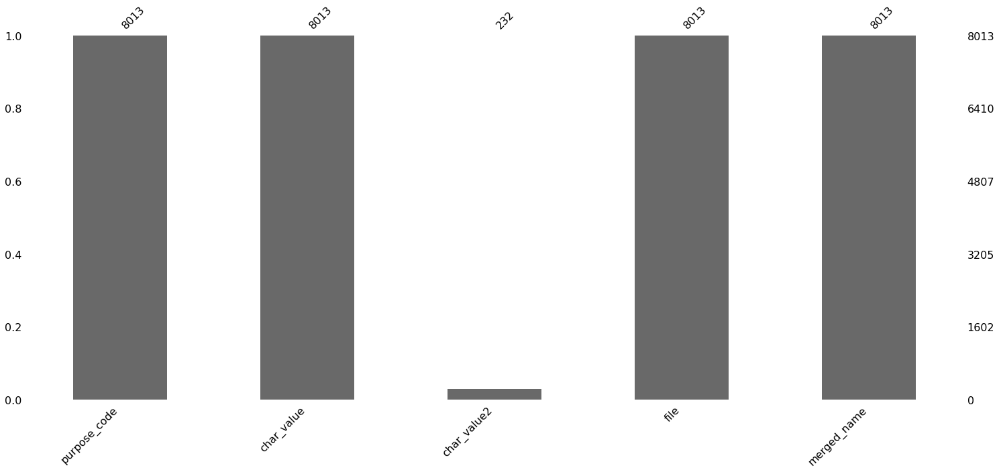

In [42]:
msno.bar(df_supportMerged)

In [43]:
def missing_zero_values_table(df):
        mis_val = df.isnull().sum()
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        mz_table = pd.concat([mis_val, mis_val_percent], axis=1)
        mz_table = mz_table.rename(columns = {0 : 'Missing Values', 1 : '% of Total Values'})
        mz_table['Data Type'] = df.dtypes
        mz_table = mz_table[
            mz_table.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns and " + str(df.shape[0]) + " Rows.\n"      
            "There are " + str(mz_table.shape[0]) +
              " columns that have missing values.")
        return mz_table

missing_zero_values_table(df_supportMerged)

Your selected dataframe has 5 columns and 8013 Rows.
There are 1 columns that have missing values.


,Missing Values,% of Total Values,Data Type
char_value2,7781,97.1,object


In [44]:
df_supportMerged[['merged_name']].value_counts()

merged_name          
0ADBGN6,Accident         1
MM15,Critical Illness    1
MM34,Critical Illness    1
MM33,Critical Illness    1
MM32,Critical Illness    1
                        ..
DA0151,Endowment         1
D80I,Disability          1
D70I,Disability          1
D2025K,Endowment         1
ZA0001,Life              1
Length: 8013, dtype: int64

In [45]:
check_duplicate = pd.DataFrame(df_supportMerged[['merged_name']].value_counts())#.reset_index().sort_values(by=0, ascending=False)
check_duplicate = check_duplicate.reset_index().rename(columns = {0:'Frequency'}).sort_values(by='merged_name')
check_duplicate

# check_support_dupe = df_supportMerged.merge(check_duplicate, on='merged_name')
# check_support_dupe
# check_support_dupe.sort_values(by=['Frequency','merged_name'], ascending=False)
# if len(check_support_dupe[check_support_dupe['Frequency']!=1]) != 0:
#     print('Duplicates Found')
# #     df_support_clean = check_support_dupe.drop_duplicates(subset="merged_name",keep='first')
# else:
#     print('No Dupes. Can proceed')
#     df_support_clean = check_support_dupe.copy()
# df_support_clean = df_support_clean.reset_index(drop=True)
# df_support_clean

,merged_name,Frequency
0,"0ADBGN6,Accident",1
4007,"0ADBGN7,Accident",1
5351,"0ADBLN6,Accident",1
5350,"0ADBLN7,Accident",1
5349,"0CB1N6,Accident",1
...,...,...
2668,"YRT8,Life",1
2667,"YRT9,Life",1
2666,"Z00001,Life",1
2665,"Z00002,Life",1


In [46]:
## WHEN CEHCK FOR DUPLICATE NEED TO CEHCK on 1st 2 cols merged name. not on the 3 col merged name.

check_duplicate = pd.DataFrame(df_supportMerged[['merged_name']].value_counts())#.reset_index().sort_values(by=0, ascending=False)
check_duplicate = check_duplicate.reset_index().rename(columns = {0:'Frequency'})
check_duplicate

check_support_dupe = df_supportMerged.merge(check_duplicate, on='merged_name')
check_support_dupe
check_support_dupe.sort_values(by=['Frequency','merged_name'], ascending=False)
if len(check_support_dupe[check_support_dupe['Frequency']!=1]) != 0:
    print('Duplicates Found')
#     df_support_clean = check_support_dupe.drop_duplicates(subset="merged_name",keep='first')
else:
    print('No Dupes. Can proceed')
    df_support_clean = check_support_dupe.copy()
df_support_clean = df_support_clean.reset_index(drop=True)
df_support_clean

No Dupes. Can proceed


,purpose_code,char_value,char_value2,file,merged_name,Frequency
0,STU1,Savers,LA,b,"STU1,Savers",1
1,AD11,Savers,LA,b,"AD11,Savers",1
2,AL70,Life,LA,b,"AL70,Life",1
3,ACE1,Payor/Waiver,LA,b,"ACE1,Payor/Waiver",1
4,AT63,Savers,LA,b,"AT63,Savers",1
...,...,...,...,...,...,...
8008,MED0,Medical,NaN,e,"MED0,Medical",1
8009,HB01,Medical,NaN,e,"HB01,Medical",1
8010,HS17,Medical,NaN,e,"HS17,Medical",1
8011,MPL1,Medical,NaN,e,"MPL1,Medical",1


In [47]:
# check_duplicate = pd.DataFrame(df_supportMerged[['merged_name']].value_counts())
# check_duplicate = check_duplicate.reset_index().rename(columns = {0:'Frequency'})
# check_support_dupe = df_supportMerged.merge(check_duplicate, on='merged_name')
# check_support_dupe.sort_values(by=['Frequency','merged_name'], ascending=False)
# if len(check_support_dupe[check_support_dupe['Frequency']!=1])== 0:
#     print('DUPLICATES FOUND!')
#     print('Proceed with cleaning')
#     df_support_clean = df_supportMerged.drop_duplicates(subset="merged_name",keep='first')
#     print(df_support_clean['file'].value_counts())
# else:
#     print("You're safe. Can proceed")
#     df_support_clean = df_supportMerged.copy()
# df_support_clean = df_support_clean.reset_index(drop=True)
# df_support_clean
#  ## No duplicates found!!

In [48]:
df_support_clean['file'].value_counts()

c    7400
e     381
b     228
d       4
Name: file, dtype: int64

In [49]:
#let's drop file and merged_name ## update, let's not. 
# df_support_clean = df_support_clean.drop(['file', 'merged_name'], axis=1)

In [50]:
# char_value_reqs = ['Medical', 'Other Medical', 'Critical Illness']
# print(df_work1['prod_cat'].isna().sum())
# df_work1['prod_cat2'] = df_work1['prod_cat'].copy()
# print(df_work1['prod_cat'].isna().sum())
# df_work1['prod_cat2'] = np.where(df_work1['prod_cat'].notnull(), df_work1['prod_cat'], 
#     (np.where((df_work1['prod_subcat_ind_1'] == 1) & (df_work1['char_value'].isin(char_value_reqs)), 'Cat 2', 
#     (np.where((df_work1['prod_subcat_ind_1'] == 1) & (df_work1['prod_subcat_ind_2'] == 1), 'Cat 2', 'Cat 3')))))
# print(df_work1['prod_cat'].isna().sum())

In [51]:
# 
## duplicates mostly come from file D and E, so need to check again how those csvs are prepared.
## centralised db for these support can be created. 

In [52]:
## now that Support is done. Let's look at main.

# Re-run Exploring Main.csv

In [53]:
df_main.describe() # these are columns detected as numerical but actually are categorical.

,policy_no,agt_cd,rider_cd,anp_rider,vit_mbr_ind,prod_subcat_ind_1,prod_subcat_ind_2
count,495854.000000,495854.000000,479533.000000,495854.000000,495854.000000,495854.000000,495854.000000
mean,150363.048819,2322.975588,10381.157230,82.296595,0.149332,0.690907,0.038233
std,134819.552961,1399.210026,1568.056582,315.805712,0.356416,0.462120,0.191759
min,1.000000,1.000000,10100.000000,0.000000,0.000000,0.000000,0.000000
25%,34625.000000,1025.000000,10101.000000,0.000000,0.000000,0.000000,0.000000
50%,105161.000000,2290.000000,10102.000000,0.000000,0.000000,1.000000,0.000000
75%,238865.000000,3529.000000,10107.000000,80.400000,0.000000,1.000000,0.000000
max,598252.000000,4810.000000,30100.000000,39999.600000,1.000000,1.000000,1.000000


<AxesSubplot:>

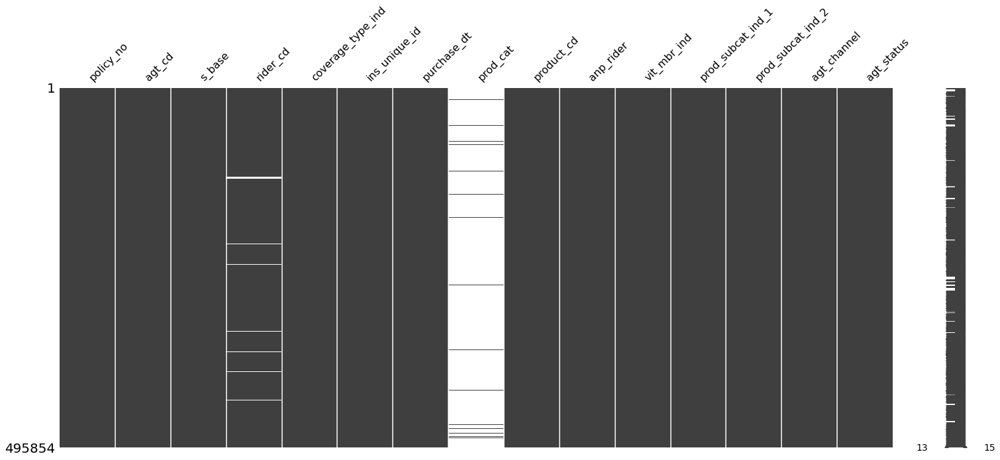

In [54]:

msno.matrix(df_main)

In [55]:
## PROD_Cat is mostly empty. the min amt of available values in a row is 11. 


<AxesSubplot:>

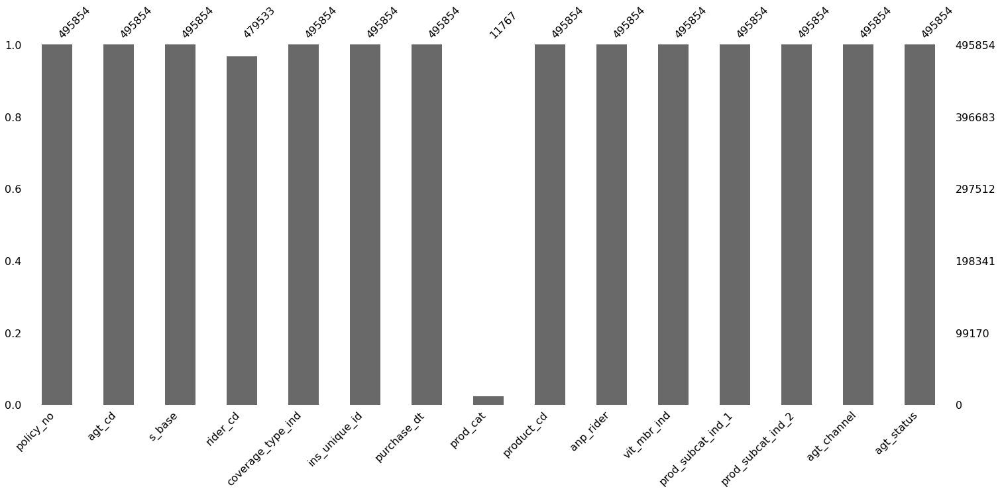

In [56]:
msno.bar(df_main) # shows the number of available data we have for each column

In [57]:
def missing_zero_values_table(df):
        mis_val = df.isnull().sum()
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        mz_table = pd.concat([mis_val, mis_val_percent], axis=1)
        mz_table = mz_table.rename(columns = {0 : 'Missing Values', 1 : '% of Total Values'})
        mz_table['Data Type'] = df.dtypes
        mz_table = mz_table[
            mz_table.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns and " + str(df.shape[0]) + " Rows.\n"      
            "There are " + str(mz_table.shape[0]) +
              " columns that have missing values.")
        return mz_table

missing_zero_values_table(df_main)

Your selected dataframe has 15 columns and 495854 Rows.
There are 2 columns that have missing values.


,Missing Values,% of Total Values,Data Type
prod_cat,484087,97.6,object
rider_cd,16321,3.3,float64


In [58]:
for col in df_main.columns:
    print(col)
    print(df_main[col].value_counts())

policy_no
23694     18
51257     17
30084     17
12556     17
28222     16
          ..
432740     1
463793     1
463985     1
573118     1
596437     1
Name: policy_no, Length: 125059, dtype: int64
agt_cd
993     2992
583     2279
2143    2037
4241    1850
3883    1629
        ... 
4688       1
2965       1
1491       1
4702       1
580        1
Name: agt_cd, Length: 3231, dtype: int64
s_base
LA          349418
LAT         130115
Accident     16321
Name: s_base, dtype: int64
rider_cd
10100.0    108724
10101.0     91271
10200.0     59849
10102.0     57345
10103.0     41687
10104.0     29790
10300.0     22338
10201.0     20550
10105.0     17583
20100.0     10242
10106.0      9156
10107.0      4271
20200.0      1596
10108.0      1521
10400.0      1245
10109.0       452
10301.0       342
10302.0       240
10303.0       235
10304.0       235
10202.0       226
20101.0       137
10110.0       135
10500.0        68
20300.0        67
10401.0        56
10111.0        47
10501.0        26
10402.

here's where we fix this problem from the notebook before. 
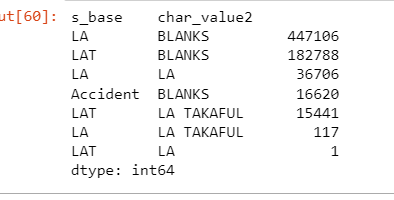


In [59]:
len(df_main)

495854

In [60]:
df_main['s_base'] = df_main['s_base'].replace(['LAT'], 'LA')
df_main['s_base'] = df_main['s_base'].replace(['LAT'], 'LA')

# and to standardize,  i need to clean df_support_clean too. Done in df_support_clean

# df_support_clean['char_value2'] = df_support_clean['char_value2'].replace(['LA TAKAFUL'], 'LA')

## now we proceed with merging. fingers crossed we get the original df length of 598269

In [61]:
df_support_clean

,purpose_code,char_value,char_value2,file,merged_name,Frequency
0,STU1,Savers,LA,b,"STU1,Savers",1
1,AD11,Savers,LA,b,"AD11,Savers",1
2,AL70,Life,LA,b,"AL70,Life",1
3,ACE1,Payor/Waiver,LA,b,"ACE1,Payor/Waiver",1
4,AT63,Savers,LA,b,"AT63,Savers",1
...,...,...,...,...,...,...
8008,MED0,Medical,NaN,e,"MED0,Medical",1
8009,HB01,Medical,NaN,e,"HB01,Medical",1
8010,HS17,Medical,NaN,e,"HS17,Medical",1
8011,MPL1,Medical,NaN,e,"MPL1,Medical",1


In [62]:

df_main1 = df_main.copy()
print('Number of data rows in Main: ', len(df_main1))
# print('Number of data rows in Support: ',len(df_support_clean))
df_support_clean['product_cd'] = df_support_clean['purpose_code'].copy()
df_support_clean
df_main1 = pd.merge(df_main1, df_support_clean, how='left', on = 'product_cd')#left_on='product_cd', right_on='purpose_code')
print('Number of data rows in Main after merging with Support: ',len(df_main1))
print('Number of data rows should remain the same after merging. Because the number increased, it means that there are STILL duplicates') 
## WHY DID MY LENGTH OF DF GO Up?! definitely duplicates coming from the merge. 
# df_main1 = df_main1.reset_index(drop=True)
# df_main1

Number of data rows in Main:  495854
Number of data rows in Main after merging with Support:  586020
Number of data rows should remain the same after merging. Because the number increased, it means that there are STILL duplicates


In [63]:
df_diff = pd.concat([df_main, df_main1])
df_diff = df_diff.reset_index(drop=True)
df_gpby = df_diff.groupby(list(df_diff.columns))
idx = [x[0] for x in df_gpby.groups.values() if len(x) == 1]
df_diff2 = df_diff.reindex(idx)
# df_diff2.to_csv('df_diff3.csv')

In [64]:
## since i can't figure out where it is, i'm going to merge 1 by one and see which support file is the problem. 

In [65]:
dfb1 = df_support_clean[df_support_clean['file']=='b']
print(len(dfb1))
dfc1 = df_support_clean[df_support_clean['file']=='c']
print(len(dfc1))
dfd1 = df_support_clean[df_support_clean['file']=='d']
print(len(dfd1))
dfe1 = df_support_clean[df_support_clean['file']=='e']
print(len(dfe1))

228
7400
4
381


In [66]:
cols_list = [dfb1, dfc1, dfd1, dfe1]
df_support_clean['merged_name'].unique().sum() == len(df_support_clean)
# dfe1[['purpose_code', 'char_value']].unique().sum()== len(dfe1)

False

In [67]:
df_main1 = df_main.copy()
print(len(df_main1))
df_main1 = pd.merge(df_main1, df_support_clean,  how='left', left_on=['product_cd','s_base'], right_on = ['purpose_code','char_value2']) 
print(len(df_main1))
#dfb1 = 598387 - 598269 = 118 extra rows
# dfc1 = NO problem
# dfd1 = = NO problem
# dfe1 = No Problem. 
# df_support_clean  = 608837- 598269 = 10568 extra rows.

495854
505954


In [68]:
df_main1[['merged_name', 'char_value2']].value_counts()

merged_name         char_value2
APH1,Other Medical  LA             8525
APH1,Medical        LA             8525
ADC5,Disability     LA             8497
AMD3,Other Medical  LA             2369
HEJB,Life           LA             2225
                                   ... 
AD11,Savers         LA                1
AD11,Accident       LA                1
5Y1C,Life           LA                1
201C,Life           LA                1
UPGA,Life           LA                1
Length: 61, dtype: int64

#after looking at the csv, it looks like the one in from File (np.nan means from main), are blanks. let's delete that
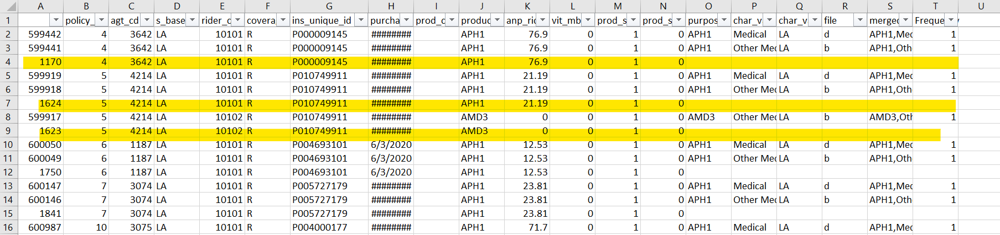

In [69]:
# #so now, let's drop the nulls in purpose cd
# df_main1 = df_main1[df_main1['purpose_code'].notna()]
# len(df_main1)


In [70]:
# df_diff = pd.concat([df_main, df_main1])
# df_diff = df_diff.reset_index(drop=True)
# df_gpby = df_diff.groupby(list(df_diff.columns))
# idx = [x[0] for x in df_gpby.groups.values() if len(x) == 1]
# df_diff2 = df_diff.reindex(idx)

In [71]:
df_main1

,policy_no,agt_cd,s_base,rider_cd,coverage_type_ind,ins_unique_id,purchase_dt,prod_cat,product_cd_x,anp_rider,...,prod_subcat_ind_2,agt_channel,agt_status,purpose_code,char_value,char_value2,file,merged_name,Frequency,product_cd_y
0,1,3640,LA,10102.0,R,P001664420,2020-03-26,NaN,ACC0,0.00,...,0,AGENCY,INFORCE,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,3640,LA,10103.0,R,P001664420,2020-03-26,NaN,AHI0,0.00,...,1,AGENCY,INFORCE,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,1,3640,LA,10108.0,R,P001664420,2020-03-26,NaN,VIT1,0.00,...,0,AGENCY,INFORCE,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1,3640,LA,10200.0,R,P001664420,2020-03-26,NaN,ART0,120.00,...,0,AGENCY,INFORCE,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,1,3640,LA,10107.0,R,P001664420,2020-03-26,NaN,ART2,0.00,...,0,AGENCY,INFORCE,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
505949,583668,4212,LA,10100.0,B,P002828561,2020-08-05,NaN,MER2,117.80,...,0,AGENCY,INFORCE,NaN,NaN,NaN,NaN,NaN,NaN,NaN
505950,583668,4212,LA,10101.0,R,P002828561,2020-08-05,NaN,APH1,29.60,...,0,AGENCY,INFORCE,APH1,Other Medical,LA,b,"APH1,Other Medical",1.0,APH1
505951,583668,4212,LA,10101.0,R,P002828561,2020-08-05,NaN,APH1,29.60,...,0,AGENCY,INFORCE,APH1,Medical,LA,d,"APH1,Medical",1.0,APH1
505952,589062,3073,LA,10100.0,B,P010685096,2020-09-22,NaN,MER2,103.46,...,0,AGENCY,INFORCE,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Answering questions in the ds_assessment pdf

Due to merging problems where the purpose code is not unique, I will answer the questions based on Main data only that's been merge with Agent data. 


In [72]:
df_main_agent.head()

,policy_no,agt_cd,s_base,rider_cd,coverage_type_ind,ins_unique_id,purchase_dt,prod_cat,product_cd,anp_rider,vit_mbr_ind,prod_subcat_ind_1,prod_subcat_ind_2,agt_channel,agt_status
0,1,3640,LAT,10102.0,R,P001664420,2020-03-26,NaN,ACC0,0.0,0,1,0,AGENCY,INFORCE
1,1,3640,LAT,10103.0,R,P001664420,2020-03-26,NaN,AHI0,0.0,0,1,1,AGENCY,INFORCE
2,1,3640,LAT,10108.0,R,P001664420,2020-03-26,NaN,VIT1,0.0,0,1,0,AGENCY,INFORCE
3,1,3640,LAT,10200.0,R,P001664420,2020-03-26,NaN,ART0,120.0,0,1,0,AGENCY,INFORCE
4,1,3640,LAT,10107.0,R,P001664420,2020-03-26,NaN,ART2,0.0,0,1,0,AGENCY,INFORCE


### Question 5

    - I am not able to do product categories with the current data due to purpose code issue. 
1. What is the total number of policies sold?
1. What is the total ANP?
##### Answer is shown in PBI sheet Question 5ia.

In [73]:
print('Purchase Date range is from ', min(df_main_agent['purchase_dt']), ' to ', max(df_main_agent['purchase_dt']))
# print('Purchase Date range number of days: ', df_main_agent['purchase_dt'].nunique())

Purchase Date range is from  2019-01-01  to  2030-07-31


Assuming that the purchase date range is correct, I will proceed to check how many policies sold within this date range

In [74]:
print('Total number of policies sold: ', df_main_agent['policy_no'].nunique())

Total number of policies sold:  154309


In [75]:
print('Total number of policies sold: ', df_main_agent['policy_no'].nunique())
print('Breakdown of number of policies sold by agents ')

Total number of policies sold:  154309
Breakdown of number of policies sold by agents 


### Question 5
2. Number of agents who sold at least 5 vitality attached policy.

In [76]:
df_main_agent['agt_status'].unique()

array(['INFORCE', 'TERMINATED', 'SUSPENDED'], dtype=object)

In [77]:
len(df_main_agent)

598269

In [78]:
def feature_engineering(df1):
    print('len df1: ', len(df1))
    df1['total_vit_attached'] = np.where(df1['vit_mbr_ind']!=0, sum(df1['vit_mbr_ind']), 0)
    print('num b')
    df1['Num_B'] = len(df1[df1['coverage_type_ind']=='B'])
    df1['Num_R'] = len(df1[df1['coverage_type_ind']=='R'])
    print('B_price')
    df1['B_price'] = df1.query('coverage_type_ind == "B"').groupby('Num_B')['anp_rider'].transform('sum')
    df1['B_price'] = df1['B_price'].fillna(0)
    print('R_price')
    df1['R_price'] = df1.query('coverage_type_ind == "R"').groupby('Num_R')['anp_rider'].transform('sum')
    df1['R_price'] = df1['R_price'].fillna(0)
    print('Fill NA R')
    return df1

In [79]:
df2=[]
df_updated=[]

for policy in df_main_agent['policy_no'].unique():
    df1 = df_main_agent[(df_main_agent['policy_no']==policy)]
    df1 = feature_engineering(df1)
    df2.append(df1)
#     print(len(df2))
df_updated = pd.concat(df2)
df_updated = df_updated.reset_index(drop=True)

len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R

C:\Users\mildred.epui\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\mildred.epui\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\mildred.epui\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[


len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_pri

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len d

B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  

R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
n

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
nu

len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_p

B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
n

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
nu

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len d

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_p

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
n

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
n

R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R


len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1

R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
nu

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_pr

B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len d

R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len 

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
n

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
nu

R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b


B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1


R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_pric

B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
n

num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
nu

B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_pric

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1: 

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_p

B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_p

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
nu

num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
nu

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
nu

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
nu

num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R


len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pri

B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2


num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill N

R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len d

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
nu

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_p

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len d

len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_pric

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price

num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R


B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
nu

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA 

len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_pric

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
nu

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_p

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
nu

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
nu

B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_pr

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
nu

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1: 

B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_pric

B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_p

num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7


num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_p

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
nu

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
n

Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_p

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_pric

num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R

num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
nu

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_pric

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill 

Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_p

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_p

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_p

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
n

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3

num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
n

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
nu

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fil

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
n

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  13
n

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
nu

num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
nu

len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
nu

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
nu

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R


B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
n

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
nu

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
nu

B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b


Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
n

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_p

B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  14
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  14
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill

B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_p

num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R


len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_pric

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
nu

len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pri

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
n

len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_pri

num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
n

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
n

B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
nu

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
nu

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
nu

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
nu

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_pric

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
nu

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1


Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_p

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
nu

num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
le

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2


R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
n

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df

num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill N

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
nu

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
nu

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_pri

len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_pric

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  

len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_pri

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_p

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
nu

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1

Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
l

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_p

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len d

num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
n

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_p

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
nu

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
nu

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10


len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_pri

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len 

num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_pric

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
n

B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R


B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_pric

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
n

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_p

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_p

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
n

num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R


num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
nu

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9


R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  13
nu

num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
nu

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
nu

num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_p

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
nu

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
nu

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
n

num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
nu

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
n

Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  11
num b


R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
n

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b


Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_p

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_p

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_pric

num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_p

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
nu

num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_pric

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
n

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_p

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11


Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_p

num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R


B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  14
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10


Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3


num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
nu

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
nu

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
nu

num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill

R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8


B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9


B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len d

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  10
num b


R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_p

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
nu

len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_pric

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
nu

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6


R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
n

len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
nu

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
nu

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
nu

len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_p

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
nu

len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_pric

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  

B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
n

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_pric

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
nu

B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R

Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_p

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1


len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_pric

num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R


len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_pric

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
nu

len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_pric

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
nu

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len d

Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
n

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
nu

num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_pric

Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8


R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
n

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7


R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
nu

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len 

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_p

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
n

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len 

B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_pr

len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_pric

len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_pr

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_pric

B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price


B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_p

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
nu

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1


R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11


Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_p

Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  15
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
n

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num 

B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len d

Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_

num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
nu

R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
n

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
nu

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_p

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len 

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
n

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
nu

len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_pric

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_pric

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  11
num b

len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pri

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_pri

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b


R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_pr

num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R


B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
nu

num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3


R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
nu

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
nu

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1: 

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_pri

Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
nu

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_pric

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7


B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
n

len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5


Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_p

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_p

B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df

len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price


R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
nu

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
nu

len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_pric

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
nu

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b


R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
n

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
nu

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
nu

R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
n

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_

Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b


B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
nu

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
nu

num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R


len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_pric

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_p

len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_pric

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
nu

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R


len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pri

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
nu

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
n

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
nu

B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  11
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
n

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
nu

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  13
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_p

Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
nu

len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_pri

Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  12
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len 

num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R

Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_pr

B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
nu

B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
n

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_pric

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
nu

R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_pric

Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_pric

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_pr

len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_pric

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_pric

len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_pric

R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_pr

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  10
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len d

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  9
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
nu

num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
nu

R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
nu

R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  4
nu

num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
nu

num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_pric

num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R


R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
nu

B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  8
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  7
num b
B_pr

Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_pr

R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  6
num b
B_price
R_price
Fill NA R
len df1:  5
num b
B_price
R_price
Fill NA R
len df1:  2
nu

Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_pr

len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  4
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_price
Fill NA R
len df1:  1
num b
B_price
R_price
Fill NA R
len df1:  3
num b
B_price
R_price
Fill NA R
len df1:  2
num b
B_price
R_pric

In [80]:
df_updated = df_updated.reset_index(drop=True)
df_updated.shape

(598269, 20)

In [81]:
# df_updated.to_csv('df_updated.csv')

Answering the questions:
Number of agents who sold at least 5 Vitality policies

REFER TO PBI attached. 

In [82]:
more_than_5vit = df_updated[df_updated['total_vit_attached']>= 5]
print(sorted(more_than_5vit['total_vit_attached'].unique()))
agt_df = more_than_5vit[(more_than_5vit['agt_status']== 'INFORCE') & (more_than_5vit['agt_channel']== 'AGENCY')]
agt_sold_more_than_5vit = agt_df[(agt_df['agt_status']== 'INFORCE') & (agt_df['agt_channel']== 'AGENCY')]['agt_cd'].nunique()
print(f'Total number of INFORCE AGENCY agents who sold at least 5 vitality attached policies: {agt_sold_more_than_5vit}')

[5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18]
Total number of INFORCE AGENCY agents who sold at least 5 vitality attached policies: 1649


In [83]:
agt_df

,policy_no,agt_cd,s_base,rider_cd,coverage_type_ind,ins_unique_id,purchase_dt,prod_cat,product_cd,anp_rider,vit_mbr_ind,prod_subcat_ind_1,prod_subcat_ind_2,agt_channel,agt_status,total_vit_attached,Num_B,Num_R,B_price,R_price
820,47,1186,LAT,10105.0,R,P004555445,2019-09-23,NaN,ART1,0.0,1,1,0,AGENCY,INFORCE,8,1,7,0.0,19.2
821,47,1186,LAT,10103.0,R,P004555445,2019-09-23,NaN,APM4,0.0,1,1,0,AGENCY,INFORCE,8,1,7,0.0,19.2
822,47,1186,LAT,10101.0,R,P004555445,2019-09-23,NaN,ATP0,0.0,1,1,0,AGENCY,INFORCE,8,1,7,0.0,19.2
823,47,1186,LAT,10200.0,R,P004555445,2019-09-23,NaN,ART0,19.2,1,1,0,AGENCY,INFORCE,8,1,7,0.0,19.2
824,47,1186,LAT,10100.0,B,P004555445,2019-09-23,NaN,AIL3,360.0,1,1,0,AGENCY,INFORCE,8,1,7,360.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
597943,369646,3061,LA,10102.0,R,P004056824,2020-10-30,NaN,APM5,0.0,1,1,0,AGENCY,INFORCE,5,1,4,0.0,0.0
597944,369646,3061,LA,10103.0,R,P004056824,2020-10-30,NaN,AWE7,0.0,1,1,0,AGENCY,INFORCE,5,1,4,0.0,0.0
597945,369646,3061,LA,10200.0,R,P004056824,2020-10-30,NaN,AT52,0.0,1,1,0,AGENCY,INFORCE,5,1,4,0.0,0.0
597946,369646,3061,LA,10100.0,B,P004056824,2020-10-30,NaN,ALL3,240.0,1,1,0,AGENCY,INFORCE,5,1,4,240.0,0.0


In [84]:
# df_diff2.to_csv('df_diff2.csv')

# Analyzing Agent Behaviours and insights generated using df_updated

In [85]:
# path = '../result_submit/'
df_updated = pd.read_csv(path+"df_updated.csv", index_col=None, header = 0).drop('Unnamed: 0', axis=1)
df_updated = df_updated[(df_updated['agt_channel']=='AGENCY') & (df_main['agt_status']=='INFORCE')]
df_updated

,policy_no,agt_cd,s_base,rider_cd,coverage_type_ind,ins_unique_id,purchase_dt,prod_cat,product_cd,anp_rider,vit_mbr_ind,prod_subcat_ind_1,prod_subcat_ind_2,agt_channel,agt_status,total_vit_attached,Num_B,Num_R,B_price,R_price
0,1,3640,LAT,10102.0,R,P001664420,3/26/2020,NaN,ACC0,0.00,0,1,0,AGENCY,INFORCE,0,1,10,0.00,120.0
1,1,3640,LAT,10103.0,R,P001664420,3/26/2020,NaN,AHI0,0.00,0,1,1,AGENCY,INFORCE,0,1,10,0.00,120.0
2,1,3640,LAT,10108.0,R,P001664420,3/26/2020,NaN,VIT1,0.00,0,1,0,AGENCY,INFORCE,0,1,10,0.00,120.0
3,1,3640,LAT,10200.0,R,P001664420,3/26/2020,NaN,ART0,120.00,0,1,0,AGENCY,INFORCE,0,1,10,0.00,120.0
4,1,3640,LAT,10107.0,R,P001664420,3/26/2020,NaN,ART2,0.00,0,1,0,AGENCY,INFORCE,0,1,10,0.00,120.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
598255,551619,4212,LA,10100.0,B,P010373499,9/13/2019,NaN,MER1,88.30,0,1,0,AGENCY,INFORCE,0,1,0,88.30,0.0
598256,583668,4212,LA,10100.0,B,P002828561,8/5/2020,NaN,MER2,117.80,0,1,0,AGENCY,INFORCE,0,1,1,117.80,0.0
598257,583668,4212,LA,10101.0,R,P002828561,8/5/2020,NaN,APH1,29.60,0,1,0,AGENCY,INFORCE,0,1,1,0.00,29.6
598267,589062,3073,LA,10100.0,B,P010685096,9/22/2020,NaN,MER2,103.46,0,1,0,AGENCY,INFORCE,0,1,0,103.46,0.0


<AxesSubplot:>

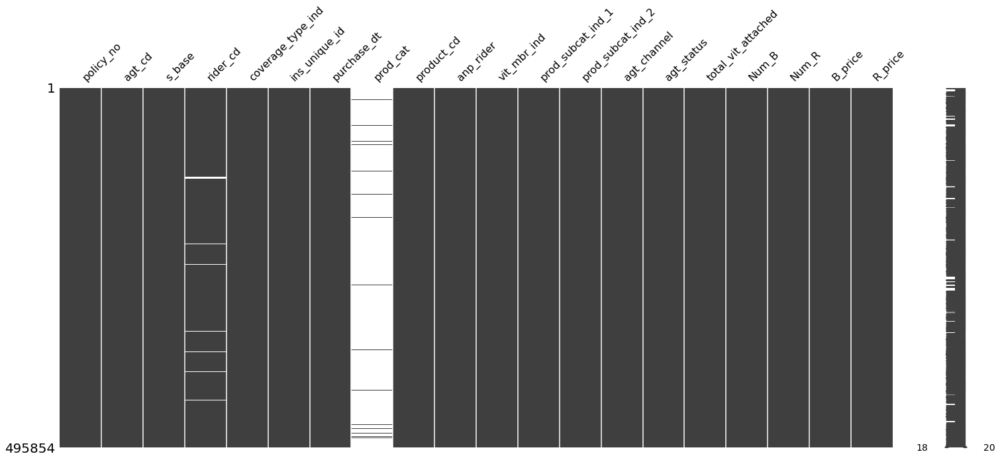

In [86]:
msno.matrix(df_updated)

In [87]:
df_updated.head()

,policy_no,agt_cd,s_base,rider_cd,coverage_type_ind,ins_unique_id,purchase_dt,prod_cat,product_cd,anp_rider,vit_mbr_ind,prod_subcat_ind_1,prod_subcat_ind_2,agt_channel,agt_status,total_vit_attached,Num_B,Num_R,B_price,R_price
0,1,3640,LAT,10102.0,R,P001664420,3/26/2020,NaN,ACC0,0.0,0,1,0,AGENCY,INFORCE,0,1,10,0.0,120.0
1,1,3640,LAT,10103.0,R,P001664420,3/26/2020,NaN,AHI0,0.0,0,1,1,AGENCY,INFORCE,0,1,10,0.0,120.0
2,1,3640,LAT,10108.0,R,P001664420,3/26/2020,NaN,VIT1,0.0,0,1,0,AGENCY,INFORCE,0,1,10,0.0,120.0
3,1,3640,LAT,10200.0,R,P001664420,3/26/2020,NaN,ART0,120.0,0,1,0,AGENCY,INFORCE,0,1,10,0.0,120.0
4,1,3640,LAT,10107.0,R,P001664420,3/26/2020,NaN,ART2,0.0,0,1,0,AGENCY,INFORCE,0,1,10,0.0,120.0


Boxplot to see distribution paid for policies

In [88]:
# highest and lowest amount paid for policy, and distribution.
df2=[]
df_updated2=[]

for policy in df_updated['policy_no'].unique():
    df1 = df_updated[(df_updated['policy_no']==policy)]#|(df_updated['policy_no']==596437) | (df_updated['policy_no']==435528)]
    df1['total_paid'] = df1['anp_rider'].sum()
    df2.append(df1)
#     print(len(df2))
df_updated2 = pd.concat(df2)
df_updated2 = df_updated2.reset_index(drop=True)

C:\Users\mildred.epui\AppData\Local\Programs\Python\Python37\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [89]:
df_updated2['anp_rider']

0           0.00
1           0.00
2           0.00
3         120.00
4           0.00
           ...  
495849     88.30
495850    117.80
495851     29.60
495852    103.46
495853    307.40
Name: anp_rider, Length: 495854, dtype: float64

In [90]:
# df_updated2.to_csv('df_updated2.csv')

In [91]:
data_rows = df_updated2['policy_no'].nunique()
print(f'The data consists of {data_rows} policies ')

The data consists of 125047 policies 


In [92]:
df_box = df_updated2[['policy_no', 'total_paid']].drop_duplicates(subset='policy_no', keep='first')
df_box
fig = px.box(df_box, y="total_paid")
fig.show()

Based on the data distribution in the box plot above, 
1. the upper outlier whisker is very long, suggesting that there are extreme values towards the higher price.
1. The maximum paid for 1 policy is <b>45,715.70</b>, where the Basic is <b>3358.5</b> and the 4 Riders totalling to <b>42,357.20</b> Policy_no is 11402 with the breakdown below. 
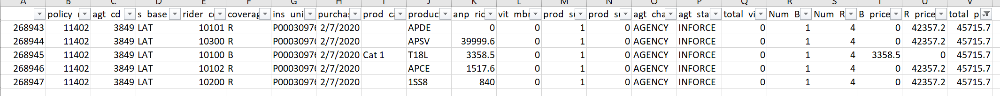
1. The Median is <b>204</b>, suggesting that most of the policies are priced as such. 
1. A policy price is considered an outlier if it is more than <b>668.4</b>
 

In [93]:
df_box[df_box['total_paid']==0]

,policy_no,total_paid
4524,60990,0.0
14417,822,0.0
16992,83668,0.0
28869,498914,0.0
44623,148211,0.0
...,...,...
495706,367271,0.0
495735,542213,0.0
495806,465941,0.0
495807,480299,0.0


1. the Minimum paid for 1 policy is 0 (157 policies have 0 basic and 0 riders paid).
1. the next minimum amount is <b>0.57</b>, where there are 2 policies paying this amount. 

In [94]:

print('Number of policies paying 9.58: ', len(df_box[df_box['total_paid']==9.58]) )
df_box[df_box['total_paid']==9.58]

Number of policies paying 9.58:  26


,policy_no,total_paid
84596,34063,9.58
84705,77085,9.58
84744,143654,9.58
84752,165053,9.58
163854,240585,9.58
180362,73555,9.58
189963,11978,9.58
190085,95011,9.58
190121,144907,9.58
190133,162569,9.58


In [95]:
df_updated2.head()

,policy_no,agt_cd,s_base,rider_cd,coverage_type_ind,ins_unique_id,purchase_dt,prod_cat,product_cd,anp_rider,...,prod_subcat_ind_1,prod_subcat_ind_2,agt_channel,agt_status,total_vit_attached,Num_B,Num_R,B_price,R_price,total_paid
0,1,3640,LAT,10102.0,R,P001664420,3/26/2020,NaN,ACC0,0.0,...,1,0,AGENCY,INFORCE,0,1,10,0.0,120.0,240.0
1,1,3640,LAT,10103.0,R,P001664420,3/26/2020,NaN,AHI0,0.0,...,1,1,AGENCY,INFORCE,0,1,10,0.0,120.0,240.0
2,1,3640,LAT,10108.0,R,P001664420,3/26/2020,NaN,VIT1,0.0,...,1,0,AGENCY,INFORCE,0,1,10,0.0,120.0,240.0
3,1,3640,LAT,10200.0,R,P001664420,3/26/2020,NaN,ART0,120.0,...,1,0,AGENCY,INFORCE,0,1,10,0.0,120.0,240.0
4,1,3640,LAT,10107.0,R,P001664420,3/26/2020,NaN,ART2,0.0,...,1,0,AGENCY,INFORCE,0,1,10,0.0,120.0,240.0


In [96]:
df_updated2['agt_channel'].unique()

array(['AGENCY'], dtype=object)

In [97]:
list(df_updated2)

['policy_no',
 'agt_cd',
 's_base',
 'rider_cd',
 'coverage_type_ind',
 'ins_unique_id',
 'purchase_dt',
 'prod_cat',
 'product_cd',
 'anp_rider',
 'vit_mbr_ind',
 'prod_subcat_ind_1',
 'prod_subcat_ind_2',
 'agt_channel',
 'agt_status',
 'total_vit_attached',
 'Num_B',
 'Num_R',
 'B_price',
 'R_price',
 'total_paid']

In [98]:
# Agent behaviours. 

# how many riders in 1 policy? what is the most frequent occuring one. 
cols = ['policy_no','agt_cd', 'Num_B', 'Num_R','B_price', 'R_price', 'total_paid','product_cd']
df_riders = df_updated2[cols]
df_riders

,policy_no,agt_cd,Num_B,Num_R,B_price,R_price,total_paid,product_cd
0,1,3640,1,10,0.00,120.0,240.00,ACC0
1,1,3640,1,10,0.00,120.0,240.00,AHI0
2,1,3640,1,10,0.00,120.0,240.00,VIT1
3,1,3640,1,10,0.00,120.0,240.00,ART0
4,1,3640,1,10,0.00,120.0,240.00,ART2
...,...,...,...,...,...,...,...,...
495849,551619,4212,1,0,88.30,0.0,88.30,MER1
495850,583668,4212,1,1,117.80,0.0,147.40,MER2
495851,583668,4212,1,1,0.00,29.6,147.40,APH1
495852,589062,3073,1,0,103.46,0.0,103.46,MER2


In [99]:
df_box = df_riders[['policy_no', 'Num_B', 'Num_R']].drop_duplicates(subset='policy_no', keep='first')
df_box
fig = px.box(df_box, y="Num_B")
fig.show()

In [100]:
print('Number of policies with 0 Basic but Riders Available: ', len(df_box[(df_box['Num_B']== 0)& (df_box['Num_R']!= 0)]) )
df_box[df_box['Num_B']== 0]
df_box[(df_box['Num_B']== 0)& (df_box['Num_R']!= 0)]


Number of policies with 0 Basic but Riders Available:  11


,policy_no,Num_B,Num_R
4524,60990,0,6
52307,31661,0,3
71301,158174,0,1
112898,128319,0,1
177597,304106,0,1
238325,194986,0,2
258862,258690,0,2
362437,201413,0,1
362442,201756,0,1
363706,366662,0,1


In [101]:
df_box

,policy_no,Num_B,Num_R
0,1,1,10
11,173,1,10
22,260,1,6
29,8997,1,10
40,15160,1,10
...,...,...,...
495848,555486,1,0
495849,551619,1,0
495850,583668,1,1
495852,589062,1,0


In [102]:
df_riders_code = df_updated2[(df_updated2['Num_B']!=0) & (df_updated2['coverage_type_ind']=='B')]
df_riders_code1 = pd.DataFrame(df_riders_code[['product_cd']].value_counts())#.reset_index().sort_values(by=0, ascending=False)
df_riders_code1 = df_riders_code1.reset_index().rename(columns = {0:'Frequency'})#.sort_values(by='product_cd')
print('Top 10 most bought Basic')
df_riders_code1.head(10)

Top 10 most bought Basic


,product_cd,Frequency
0,ALL3,27026
1,MER2,12990
2,ALR0,9846
3,MER1,9077
4,PFC,7826
5,ALJ1,7358
6,AIL3,7010
7,MED9,6777
8,PTW,4203
9,PEA,4038


## Which agent sold the most, and usually sell how many?

In [103]:
## Which agent sold the most, and usually sell how many?
df_agent_policy = df_riders[['policy_no', 'agt_cd']].drop_duplicates(subset='policy_no', keep='first')
df_agent_policy
check_duplicate = df_agent_policy[['agt_cd']].value_counts()
check_duplicate = check_duplicate.reset_index().rename(columns = {0:'Number of Policies sold'})#.sort_values(by='merged_name')
check_duplicate
# df_box = df_riders[['policy_no', 'agt_cd', 'Num_R']].drop_duplicates(subset='policy_no', keep='first')
# df_box
fig = px.box(check_duplicate, y="Number of Policies sold")
fig.show()

# IMPORTANT!!
# How do I know the run is complete?
Above this cell, there should be a boxplot that looks like this. If shown, it means the run is completed. 

please refer to the image below. 
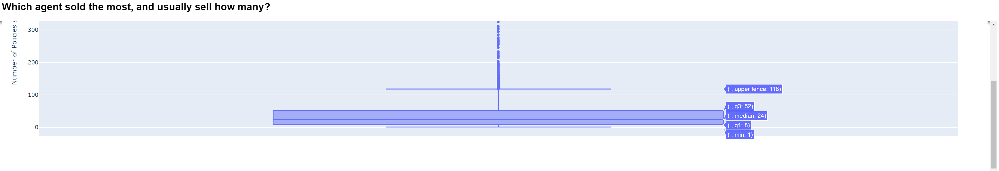


End here

Notes:


By the end of the challenge, we hope to see:
- i. Agent segments based on their selling behaviour and interpretation of these segments. <- maybe doable
- see by agent sell dates, 
- num b and num r how many they usually sell together, what kind of product code always together.
- prices of combine b_r
- can create labels for BR and labels for total policy price. then re-label using the 2 labels and plot count. 
- from here, which months can target best to sell which policy. look at trending by months. Note: 
- ii. A product category score assigned to agents. (Optional) <- hard cos category need to be assigned based on product code. 
- i. By product categories?
- a. What is the total number of policies sold? <- doable. calculate policy in main instead.
- b. What is the total ANP? <- doable. check anp_rider. 
- ii. Number of agents who sold at least 5 Vitality attached policy. - groupby agt cd, add vit_mbr_ind, and see >=5. 
- iii. Number of policies with at least 3 riders attached. - groupby policy number, for every B, count how many R. if more than 3, label. 
- 
ML SIDE
1. We are interested in understanding AGENT’s selling behaviour. <- can do clustering? see how many types of agents
1. easier looking at policy rather than rider. but see how. 
1. THIS ONE IMPORTNAT
i. Agent segments based on their selling behaviour and interpretation of these segments.
ii. A product category score assigned to agents. (Optional)
1. 


In [104]:
## going back to df_support_clean, im gonna drop all other medical from the lists of codes at the top. 
df_support_clean.head()
df2=[]
df3=[]
df4=[]

for productcode in check_duplicate_main['product_cd'].unique():
#     print(productcode)
    if productcode == 'AD11':
        df1 = df_main1[df_main1['product_cd'] == productcode]
        df1['char_value'] = df1['char_value'].replace(['Savers'], 'Accident/Savers')
        df1['char_value'] = df1['char_value'].replace(['Accident'], 'Accident/Savers')
        print(df1)
    elif productcode == 'APT1': 
        df1 = df_main1[df_main1['product_cd'] == productcode]
        df1['char_value'] = df1['char_value'].replace(['Disability'], 'Disability/Life')
        df1['char_value'] = df1['char_value'].replace(['Life'], 'Disability/Life')
    else:
        df1 = df_main1[df_main1['product_cd'] == productcode]
        df1['char_value'] = df1['char_value'].replace(['Medical'], 'Medical/Other Medical')
        df1['char_value'] = df1['char_value'].replace(['Other Medical'], 'Medical/Other Medical')
    df2.append(df1)
df3 = pd.concat(df2)
#         df1['char_value'] = df1 

KeyError: 'product_cd'

##### To re-visit: codes to add Cat 1, 2,3


#####  the below shows that i need to change the highlighted ones, and the red line into cat 2. The rest all Cat 3
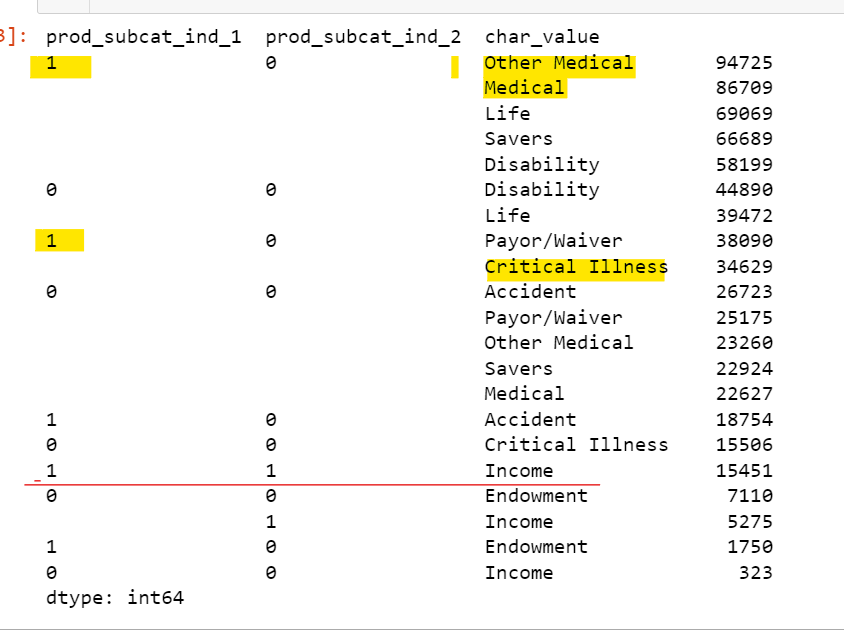

In [ ]:
break # so the codes below do not run.

In [ ]:
df_diff2['prod_cat'].unique()

In [ ]:
print("How many extra rows???")
len(df_main1)-len(df_main)

In [ ]:
# is it cos my df support clean isn't clean??
check_duplicate = df_support_clean[['purpose', 'merged_name', 'file']].value_counts()
check_duplicate = check_duplicate.reset_index().rename(columns = {0:'Frequency'})#.sort_values(by='merged_name')
check_duplicate ## nope. frquency starts with 1. 

In [ ]:
df_main1 = df_main1.drop(['Frequency'], axis=1)

In [ ]:
list(df_main)

In [ ]:
list(df_main2)

In [ ]:
df_diff = pd.concat([df_main, df_main2])
df_diff = df_diff.reset_index(drop=True)
df_gpby = df_diff.groupby(list(df_diff.columns))
idx = [x[0] for x in df_gpby.groups.values() if len(x) == 1]

In [ ]:
df_main2.compare(df_main)


In [ ]:
# df_main1 = df_main.copy()
## let's look at dfmain 1. Omg. Frequency 34918. 
# ew. is it cos of the medical/other medical?
check_duplicate_main = df_main1[['product_cd', 'merged_name', 'file']].value_counts()
check_duplicate_main = check_duplicate_main.reset_index().rename(columns = {0:'Frequency'}).sort_values(by=['Frequency','merged_name'], ascending=False)
check_duplicate_main

In [ ]:
check_duplicate_main[check_duplicate_main.duplicated(subset=['product_cd'], keep=False)].sort_values(by='merged_name') 
# honestly i don't know why we have other medical. its causing more duplicates. 
## but we did pick up accident and savers for AD11 and APT1's disability and life. 

## you know what, i'm just going to change them and combine them. as Medical/Other Medical (why? cos in the sql specifically asked for other medical). 
## Then change AD11's accident into accident+savers, same for APT1

In [ ]:
df_main1.head()

In [ ]:
len(df_main)

In [ ]:
len(df_main1)

In [ ]:
## going back to df_support_clean, im gonna drop all other medical from the lists of codes at the top. 
df_support_clean.head()
df2=[]
df3=[]
df4=[]

for productcode in check_duplicate_main['product_cd'].unique():
#     print(productcode)
    if productcode == 'AD11':
        df1 = df_main1[df_main1['product_cd'] == productcode]
        df1['char_value'] = df1['char_value'].replace(['Savers'], 'Accident/Savers')
        df1['char_value'] = df1['char_value'].replace(['Accident'], 'Accident/Savers')
        print(df1)
    elif productcode == 'APT1': 
        df1 = df_main1[df_main1['product_cd'] == productcode]
        df1['char_value'] = df1['char_value'].replace(['Disability'], 'Disability/Life')
        df1['char_value'] = df1['char_value'].replace(['Life'], 'Disability/Life')
    else:
        df1 = df_main1[df_main1['product_cd'] == productcode]
        df1['char_value'] = df1['char_value'].replace(['Medical'], 'Medical/Other Medical')
        df1['char_value'] = df1['char_value'].replace(['Other Medical'], 'Medical/Other Medical')
    df2.append(df1)
df3 = pd.concat(df2)
#         df1['char_value'] = df1 

In [ ]:
df3[df3['product_cd']=='APT1'] 
## YAY!! Now i can drop duplicates!! because the only thing that is different is the merged names.
# just to be sure, let's check whether df3's duplicate length == df_main1's duplicate length, and the set of unique in their merged_name. 
## If yes, then just drop merged_name(cos not applicable anymore, and drop duplicates. 

## put this problem on hold first. <- SOLVED

In [ ]:
df3[df3.duplicated(subset=['policy_no', 'ins_unique_id','purchase_dt','merged_name'], keep=False)].sort_values(by='merged_name')

In [ ]:
df3[df3['product_cd']=='AD11'] 

In [ ]:
df_work1[['prod_subcat_ind_1', 'prod_subcat_ind_2','char_value']].value_counts()


In [ ]:
# in the data dictionary, it's also mentioned that i can join main's s_base with char value2. 
# check whether s_base = char_value2 
# s = df_main1.groupby('s_base')['char_value2'].nunique()
# vals = s.index[s.ne(1)].tolist()
# vals ## none means all same

# vals = df_main1[df_main1.groupby('s_base')['char_value2'].transform('nunique').ne(1)]
# vals
df_main1["exists"] = df_main1.drop("s_base", 1).isin(df_main1["s_base"]).any(1)
df_main1[df_main1['exists']==False]

## if char_value2 is false, i can just fill replace char_value2 as s_base. 

In [ ]:
# check whether char_value2 is all nulls. if yes, fill char value2 with sbase
df_false = df_main1[df_main1['exists']==False]

df_false['char_value2'].isnull().sum == len(df_false) ## It's not all null!! 
df_false = df_false.dropna(subset=['char_value2'])[df_false.columns] # found 118 columns that are not null
df_false[['s_base', 'char_value2']].value_counts()
## Ok, fine. so maybe the blanks makes a difference cos i'm not capturing all of the 645453 rows. (honestly, i'm only supposed to have 598269 in df_main. after merging, it increased.)

In [ ]:
## before merging, check whether agt_cd is unique, and whether range is the same as main's agt_cd
min_col = df_agent['agt_cd'].min()
max_col = df_agent['agt_cd'].max()

if df_agent['agt_cd'].nunique()==len(df_agent):
    print('AGT_CD is unique')## True, means it's unique
else: 
    print('This column has duplicates')
if df_agent['agt_cd'].max() == len(df_agent):## true means the max number is the length number
    print(f'AGT_cd numbering is from {min_col} to {max_col}, same as the length of the df, {len(df_agent)}')
else:
    print(f'AGT_cd numbering is NOT in a series because it ranges from {min_col} to {max_col}, which is different from the total rows available ({len(df_agent)})')

In [ ]:
# df_null = df_try[df_try['prod_cat'].isna()]
# df_null
# char_value_reqs = ['Medical', 'Other Medical', 'Critical Illness']
# df_null['prod_cat2'] = df_null['prod_cat'].copy()
# df_null['prod_cat2'] = np.where((df_null['prod_subcat_ind_1'] == 1) & (df_null['char_value'].isin(char_value_reqs)), 'Cat 2', 
#                                 (np.where((df_null['prod_subcat_ind_1'] == 1) & (df_null['prod_subcat_ind_2'] == 1), 'Cat 2', 'Cat 3')))
# df_null

In [ ]:
# df_null[['prod_cat2','prod_subcat_ind_1', 'prod_subcat_ind_2', 'char_value']].value_counts()

In [ ]:
# df_null = df_try[df_try['prod_cat'].isna()]
# df_null
char_value_reqs = ['Medical', 'Other Medical', 'Critical Illness']
print(df_work1['prod_cat'].isna().sum())
df_work1['prod_cat2'] = df_work1['prod_cat'].copy()
print(df_work1['prod_cat'].isna().sum())
df_work1['prod_cat2'] = np.where(df_work1['prod_cat'].notnull(), df_work1['prod_cat'], 
    (np.where((df_work1['prod_subcat_ind_1'] == 1) & (df_work1['char_value'].isin(char_value_reqs)), 'Cat 2', 
    (np.where((df_work1['prod_subcat_ind_1'] == 1) & (df_work1['prod_subcat_ind_2'] == 1), 'Cat 2', 'Cat 3')))))
print(df_work1['prod_cat'].isna().sum())

In [ ]:
df_work1[['prod_cat2','prod_subcat_ind_1', 'prod_subcat_ind_2', 'char_value']].value_counts()

In [ ]:
# df_try['prod_cat_fill'] = df_try['prod_cat'].copy()
# print(df_try['prod_cat'].isna().sum())
# df_try['prod_cat_fill'] = df_try['prod_cat_fill'].fillna('BLANKSS')
# print(df_try['prod_cat'].isna().sum())
# df_try
# df_try['new_cat']=df_try["prod_cat_fill"] + ',' + df_try["prod_cat2"]
# df_try['new_cat'].value_counts()

In [ ]:
df_work1.head()

In [ ]:
# ## Working file is ready! Now let's explore working file in pbi?
# df_work.to_csv('AIA_work_file.csv', index=False)

In [ ]:
# df_try.to_csv('df_try.csv')

In [ ]:
# df_work1['policy_cat_id'] = df_work1.groupby(['policy_no','prod_cat2']).ngroup().replace(-1,np.nan).add(1)
# df_work1['policy_cat_id'].value_counts()

In [ ]:
df_work2 = df_work1.copy()

In [ ]:
#create newID
df_work2.insert(0, 'New_ID', range(999, 999 + len(df_work2)))
df_work2['New_ID'].nunique() == len(df_work2)


In [ ]:
df1 = df_work2[df_work2['policy_no']==64946]
len(df1[df1['coverage_type_ind'] == 'B']) ## check that every policy only has 1 b


In [ ]:
# df_work2['cat_number'] = df_work2['prod_cat2'].str.strip().str[-1]
# df_work2
# df_work2['cat_number'].value_counts()

In [ ]:
pd.DataFrame(df_work2[['coverage_type_ind', 'cat_number','policy_no']].value_counts()).sort_values(by='coverage_type_ind')

In [ ]:
multiple_basic=[]
one_basic=[]

for i in df_work2['policy_no'].unique():
    df1 = df_work2[df_work2['policy_no']==i]
    if len(df1[df1['coverage_type_ind'] == 'B']) !=1:
        print('Multiple Basic')
        multiple_basic.append(i)
    else:
        one_basic.append(i)
        ## check that every policy only has 1 b
print(len(multiple_basic))
print(len(one_basic))